In [1]:
from asyncio import subprocess
from curses.ascii import NUL
import matplotlib.pyplot as plt
import matplotlib.image as img
from PIL import Image
import numpy as np
import glob
import cv2
from utils import dice_score
from pandas import cut
from torch import zero_
from torch import tensor

/tmp/ipykernel_17615/1011367825.py:50: DeprecationWarning: `np.long` is a deprecated alias for `np.compat.long`. To silence this warning, use `np.compat.long` by itself. In the likely event your code does not need to work on Python 2 you can use the builtin `int` for which `np.compat.long` is itself an alias. Doing this will not modify any behaviour and is safe. When replacing `np.long`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  dice = dice_score.dice_coeff(tensor((predic/127).astype(np.long)), tensor(ground_truth.astype(np.long)))


 Yellow = True Positif, Green = False Positif (in Predic and not GT, Blue = Negative (in GT and not Predict)


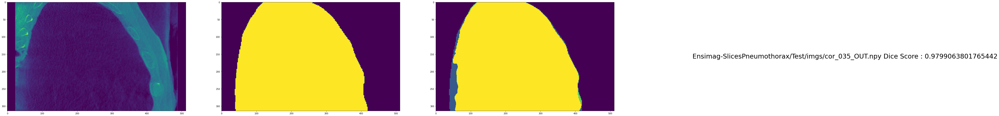

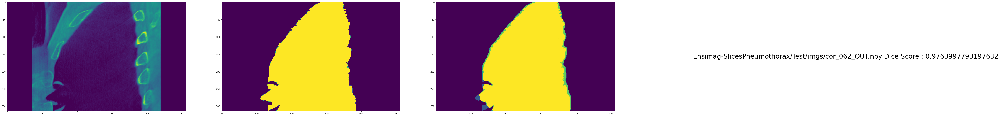

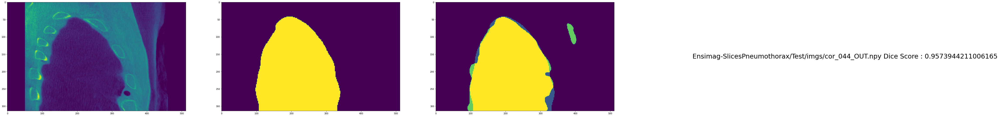

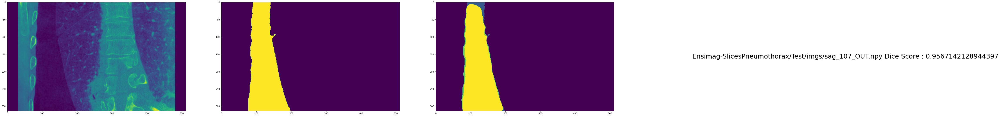

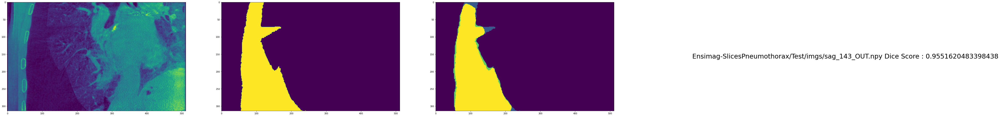

...

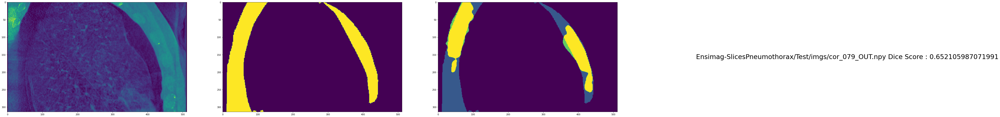

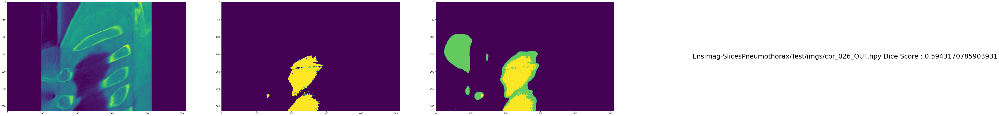

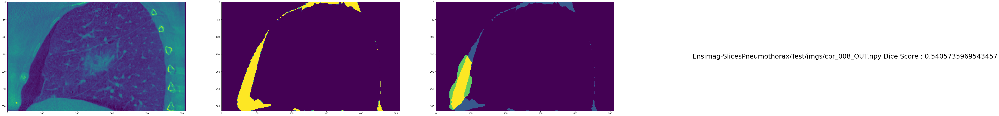

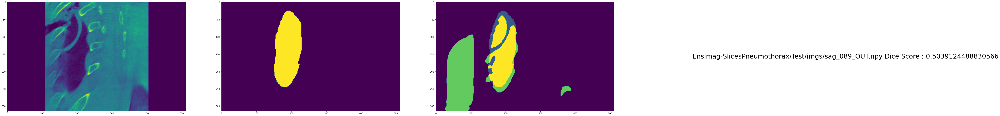

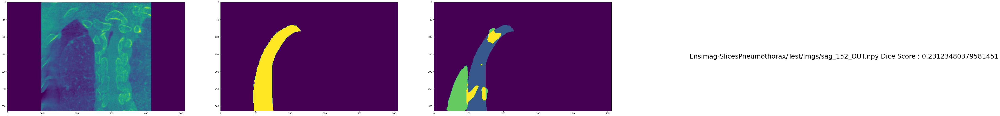

In [77]:
"""affiche les deux nbres de l'image"""
def numbers(image):
    L= []
    for i in range(len(image)):
        for j in range(len(image[0])):
            if(image[i][j] not in L):
                L += [image[i][j]]
    return L

"""255 du ground_truth en 129"""
def convert(image):
    for i in range(len(image)):
        for j in range(len(image[0])):
            if (image[i][j] != 0):
                image[i][j] = 129
    return image


def compare(predic, ground_truth):
    for i in range(len(predic)):
        for j in range(len(predic[0])):  
            if (ground_truth[i][j] == 129):
                if (predic[i][j] != ground_truth[i][j]):
                    predic[i][j] = 70 # False Negatif
            if (predic[i][j] == 129):
                if (predic[i][j] == ground_truth[i][j]):
                    predic[i][j] = 250   #True Positif
                    a = 1
                else:
                    predic[i][j] = 190   #False Positif

                
    return predic
    
    
    
files = glob.glob("Ensimag-SlicesPneumothorax/Test/imgs/*_OUT.npy")

plt.rcParams['figure.figsize'] = [50, 50]


line = []

Dice = []

for i, file in enumerate(files):
    predic = np.load(file)
    img_array = np.load(file.replace("_OUT.npy", ".npy"))
    ground_truth = np.load(file.replace("imgs", "masks").replace("_OUT.npy", "_mask.npy"))
    dice = dice_score.dice_coeff(tensor((predic/127).astype(np.long)), tensor(ground_truth.astype(np.long)))
    predic *= 255
    ground_truth *= 255
    ground_truth = convert(ground_truth)
    predic = compare(predic, ground_truth)
    line.append([img_array, ground_truth , predic, dice, file])
    Dice += [float(dice)] 


    
    
    
line.sort(key=lambda x : -x[3])
    
    
    
print(" Yellow = True Positif, Green = False Positif (in Predic and not GT, Blue = Negative (in GT and not Predict)")    
    

for file in line:
    fig, axs = plt.subplots(1, 3)
    fig.text(1,0.5, file[4]+" Dice Score : "+str(file[3].item()), fontsize=30)
    axs[0].imshow(file[0])
    axs[1].imshow(file[1])
    axs[2].imshow(file[2])

    plt.show()